# «E-commerce — Анализ товарного ассортимента»

## Описание проекта

Для интернет-магазина товаров для дома «Пока все ещё тут», необходимо сделать анализ товарного ассортимента. 

**Цели проекта**:
 - проведите исследовательский анализ данных;
 - проанализируйте торговый ассортимент;
 - выделите основной и дополнительный ассортимент;
 - сформулируйте и проверьте статистические гипотезы.

## Описание данных

**Таблица `ecommerce` (датасет описывает транзакции интернет-магазина товаров для дома и быта «Пока все ещё тут»)**

 - date — дата заказа;
 - customer_id — идентификатор покупателя;
 - order_id — идентификатор заказа;
 - product — наименование товара;
 - quantity — количество товара в заказе;
 - price — цена товара.

## Декомпозиция

**Шаг 1. Загрузка, просмотр и предобработка данных**

**Шаг 2. Исследовательский анализ данных**

**Шаг 3. Категоризация наименования товара**

**Шаг 4. Выделение основного и дополнительного ассортимента**

**Шаг 5. Проверка гипотез (еще не сформулировал)**

**Шаг 6. Общие выводы и рекомендации**

## Загрузка, просмотр и предобработка данных

In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

import datetime as dt
from datetime import datetime
import re
import nltk
from nltk.tokenize import word_tokenize 
from nltk.corpus import stopwords
from nltk.stem import WordNetLemmatizer
from itertools import chain

import scipy.stats as st

import warnings
warnings.simplefilter('ignore')

In [2]:
google_id = "1DkqEQWZoHh22YrsYcNUxSzlhgFqdl0tf"
data = pd.read_csv(f"https://drive.google.com/uc?export=download&id={google_id}" )
data.head()


,date,customer_id,order_id,product,quantity,price
0,2018100100,ee47d746-6d2f-4d3c-9622-c31412542920,68477,"Комнатное растение в горшке Алое Вера, d12, h30",1,142.0
1,2018100100,ee47d746-6d2f-4d3c-9622-c31412542920,68477,"Комнатное растение в горшке Кофе Арабика, d12,...",1,194.0
2,2018100100,ee47d746-6d2f-4d3c-9622-c31412542920,68477,Радермахера d-12 см h-20 см,1,112.0
3,2018100100,ee47d746-6d2f-4d3c-9622-c31412542920,68477,Хризолидокарпус Лутесценс d-9 см,1,179.0
4,2018100100,ee47d746-6d2f-4d3c-9622-c31412542920,68477,Циперус Зумула d-12 см h-25 см,1,112.0


In [3]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7474 entries, 0 to 7473
Data columns (total 6 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   date         7474 non-null   int64  
 1   customer_id  7474 non-null   object 
 2   order_id     7474 non-null   int64  
 3   product      7474 non-null   object 
 4   quantity     7474 non-null   int64  
 5   price        7474 non-null   float64
dtypes: float64(1), int64(3), object(2)
memory usage: 350.5+ KB


In [4]:
#приведем дату к формату даты
data['date'] = pd.to_datetime(data['date'], format='%Y%m%d%H')

In [5]:
# выделяем день недели для каждой даты
data['day_of_week'] = data['date'].dt.weekday

# создаем новую колонку "Тип дня"
data['day_of_week'] = data['day_of_week'].apply(lambda x: 'weekend' if x in [5,6] else 'weekday')

In [6]:
# выделяем час для каждой даты
data['hour'] = pd.to_datetime(data['date']).dt.hour

In [7]:
#проверим датасет на наличие дубликатов
print('Кол-во дубликатов в датасете -', data.duplicated().sum())

Кол-во дубликатов в датасете - 0


In [8]:
#посмотрим на неявные дубликаты, т.е. заказы без учета даты
print('Кол-во неявных дубликатов в датасете -',
      data.duplicated(subset=['order_id', 'product', 'quantity', 'price']).sum())

Кол-во неявных дубликатов в датасете - 1903


**Мы видим, что при поиске дубликатов без учета даты заказа, в датасете находится 1903 дубликата. Возможная причина, такого кол-ва дубликатов - сбои при записи, либо при выгрузке данных. Поэтому принимаю решение их удалить.**

In [9]:
data = data.drop_duplicates(subset=['order_id', 'product', 'quantity', 'price'])

In [10]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 5571 entries, 0 to 7473
Data columns (total 8 columns):
 #   Column       Non-Null Count  Dtype         
---  ------       --------------  -----         
 0   date         5571 non-null   datetime64[ns]
 1   customer_id  5571 non-null   object        
 2   order_id     5571 non-null   int64         
 3   product      5571 non-null   object        
 4   quantity     5571 non-null   int64         
 5   price        5571 non-null   float64       
 6   day_of_week  5571 non-null   object        
 7   hour         5571 non-null   int64         
dtypes: datetime64[ns](1), float64(1), int64(3), object(3)
memory usage: 391.7+ KB


**Дубликаты были удалены, можно продолжить анализ**

In [11]:
unique_product_list = np.unique(data['product']).tolist()
#display(unique_product_list)

data['product'].nunique()

2343

In [12]:
#чтобы не было задвоения, заменим "ё" на "е" и приведем наименования товара к единому регистру
data['product'] = data['product'].str.lower()
data['product'] = data['product'].replace(',', '')
data['product'] = data['product'].replace('ё', 'е')
data['product'] = data['product'].replace('ампельнвя', 'ампельная')
data['product'] = data['product'].replace('алюминевая', 'алюминиевая')
data['product'] = data['product'].replace('алое', 'алоэ')

In [13]:
data['product'].nunique()

2341

**Пропусков и дубликатов нет. Данные приведены к нужному типу**

## Исследовательский анализ данных

In [14]:
#посмотрим на числовые данные датасета
data.describe()

,order_id,quantity,price,hour
count,5571.000000,5571.000000,5571.000000,5571.000000
mean,51007.084545,2.577455,529.973449,13.962125
std,26648.041035,16.450684,972.840697,4.935181
min,12624.000000,1.000000,9.000000,0.000000
25%,14810.000000,1.000000,90.000000,11.000000
50%,69101.000000,1.000000,150.000000,14.000000
75%,71038.500000,1.000000,524.000000,17.000000
max,73164.000000,1000.000000,14917.000000,23.000000


In [15]:
#посмотрим датасет по категориальным признакам
data.describe(include=[object])

,customer_id,product,day_of_week
count,5571,5571,5571
unique,2432,2341,2
top,c971fb21-d54c-4134-938f-16b62ee86d3b,пеларгония розебудная red pandora укорененный ...,weekday
freq,143,66,4326


In [16]:
#посмотрим столбец с датой и временем
data[['date']].describe()

,date
count,5571
unique,2725
top,2019-04-27 16:00:00
freq,51
first,2018-10-01 00:00:00
last,2020-01-31 15:00:00


**Из выше сделаного можно сказать следующее:**

 - среднее кол-во купленого товара равно 2.4 шт., но есть и заказ с 1000 шт.;
 - средняя цена товара равна 530 у.е.;
 - самый покупаемый товар "пеларгония розебудная red pandora" его купили 66 раз;
 - период в датасете: 01 октября 2018 - 31 января 2020.

**Проверим датасет на выбросы. Для этого можно расчитать общий доход с заказов.**

In [17]:
#создадим новый столбец 'income', для которого перемножим 'quantity' и 'price'
data['income'] = data['quantity'] * data['price']

In [18]:
data.sort_values(by='income', ascending=False).head(10)

,date,customer_id,order_id,product,quantity,price,day_of_week,hour,income
5456,2019-06-18 15:00:00,312e9a3e-5fca-43ff-a6a1-892d2b2d5ba6,71743,"вантуз с деревянной ручкой d14 см красный, bur...",1000,675.0,weekday,15,675000.0
5071,2019-06-11 07:00:00,146cd9bf-a95c-4afb-915b-5f6684b17444,71668,вешалки мягкие для деликатных вещей 3 шт шоколад,334,148.0,weekday,7,49432.0
1518,2019-01-15 13:00:00,58a4c3cc-504f-43ea-a74a-bae19e665552,69830,простынь вафельная 200х180 см wellness rw180-0...,27,1755.0,weekday,13,47385.0
1299,2018-12-21 16:00:00,6987e6d6-a63a-4ce2-a2d0-f424092d235e,69504,тележка багажная delta тбр-22 синий грузоподъе...,57,574.0,weekday,16,32718.0
1023,2018-11-29 17:00:00,8fba3604-ef57-4b9f-b2fe-3402fa8825c8,69156,набор ножей attribute chef 5 предметов akf522,64,457.0,weekday,17,29248.0
661,2018-11-06 12:00:00,1b2764ad-9151-4051-a46a-9b01b62e6335,68878,"урна уличная ""гео"", hobbyka/хоббика, 59*37,5см...",5,4874.0,weekday,12,24370.0
1675,2019-02-04 06:00:00,909564b8-3a5c-4d3e-8310-5ba1c837bbd7,70080,мусорный контейнер hailo bigbin swing 45 0845-...,3,5512.0,weekday,6,16536.0
2971,2019-04-19 19:00:00,498f12a4-6a62-4725-8516-cf5dc9ab8a3a,71206,одеяло wellness t142 белое темостеганое 140х20...,10,1568.0,weekday,19,15680.0
3961,2019-05-20 21:00:00,5d189e88-d4d6-4eac-ab43-fa65a3c4d106,71478,муляж яблоко 9 см красное,300,51.0,weekday,21,15300.0
5992,2019-07-29 17:00:00,0d87f4ae-465a-4fac-81e6-5d629761783e,72139,сушилка уличная leifheit 85210 linomatic v 400...,1,14917.0,weekday,17,14917.0


In [19]:
#сгруппируем таблицу по 'order_id', чтобы посмотреть общую выручку по заказу
data.groupby('order_id')['income'].sum().sort_values(ascending=False)

order_id
71743    675000.0
71668     49432.0
69830     47385.0
69156     33680.0
69504     32718.0
           ...   
71178        22.0
71125        22.0
70988        22.0
73040        22.0
68985        15.0
Name: income, Length: 2784, dtype: float64

**Для наглядности построим "ящик с усами"**

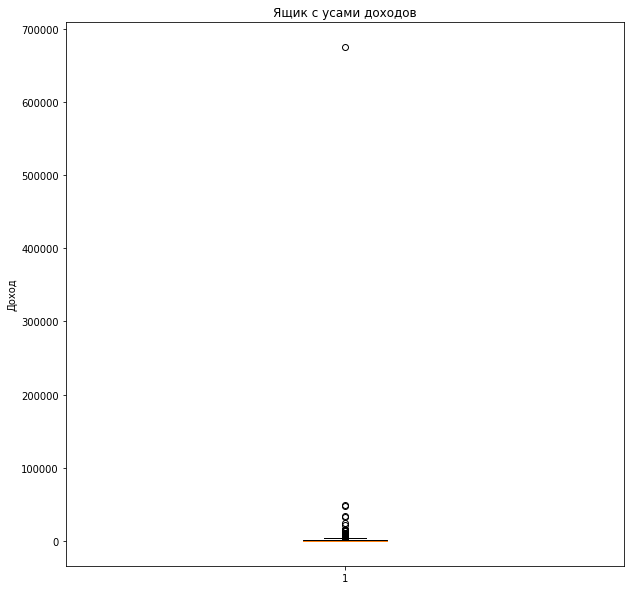

In [20]:
income_group = data.groupby('order_id')['income'].sum().sort_values(ascending=False)

plt.figure(figsize=(10, 10))
plt.boxplot(income_group)
plt.title("Ящик с усами доходов")
plt.ylabel("Доход")
plt.show()

**Видим сильный выброс 675000 у.е., поэтому найдем 99 перцентилей**

In [21]:
np.percentile(income_group, [99])

array([8672.38])

**Не более чем у 1% заказов чек больше 8672 у.е. В связи с этим данные заказы будем считать выбросами, поэтому надо оценить их кол-во и решить дальнейшую их судьбу**

In [22]:
income_99 = np.percentile(income_group, 99)
print('Кол-во заказов, которые попали в выброс -', income_group[income_group > income_99].count())

Кол-во заказов, которые попали в выброс - 28


In [23]:
income_28 = income_group[income_group > income_99].index
display(income_28)

Int64Index([71743, 71668, 69830, 69156, 69504, 68878, 68760, 70080, 71206,
            71478, 72139, 71205, 69681, 71204, 71598, 69928, 70135, 14735,
            72552, 69127, 69150, 68727, 71155, 71685, 72162, 68529, 71035,
            70423],
           dtype='int64', name='order_id')

In [24]:
whos_gone = data.query('order_id in @income_28')
display(whos_gone)

,date,customer_id,order_id,product,quantity,price,day_of_week,hour,income
98,2018-10-04 17:00:00,d1a13243-9111-454f-848c-dcce0958528c,68529,сумка-тележка хозяйственная andersen scala sho...,1,5024.0,weekday,17,5024.0
99,2018-10-04 17:00:00,d1a13243-9111-454f-848c-dcce0958528c,68529,сумка-тележка хозяйственная rolser jet cuadro ...,1,3734.0,weekday,17,3734.0
375,2018-10-23 11:00:00,4d93d3f6-8b24-403b-a74b-f5173e40d7db,68727,"веник сорго с деревянной ручкой с 4-мя швами, ...",17,530.0,weekday,11,9010.0
416,2018-10-26 13:00:00,9f1e7d7d-ff10-4eb1-b596-1cbf8075aa3f,68760,вешалка деревянная с расширенными плечиками и ...,8,262.0,weekday,13,2096.0
417,2018-10-26 13:00:00,9f1e7d7d-ff10-4eb1-b596-1cbf8075aa3f,68760,вешалка для блузок 41 см черный attribute ahm791,9,50.0,weekday,13,450.0
...,...,...,...,...,...,...,...,...,...
6829,2019-11-11 12:00:00,88b127c0-5753-4e21-b9eb-fb2b1537827a,69150,сумка-тележка хозяйственная rolser pack gloria...,1,6558.0,weekday,12,6558.0
6913,2019-11-24 15:00:00,ad66d870-22f5-43bc-958f-73420822586b,69681,гладильная доска leifheit airboard compact m p...,1,7424.0,weekend,15,7424.0
7039,2019-12-12 16:00:00,ac250053-a236-467a-97d2-ddbb9bf4a1ba,70423,"контейнер для продуктов pasabahce 1,25 л голуб...",1,247.0,weekday,16,247.0
7190,2019-12-31 10:00:00,f279d50f-a508-40b4-bde5-5cb4a1be3ad0,71155,сумка-тележка хозяйственная rolser imx006 bass...,1,7679.0,weekday,10,7679.0


In [25]:
whos_gone['product'].nunique()

65

In [26]:
# снимаем ограничения в pandas на количество выводимых рядов и колонок,
# а также на ширину колонок
pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)
pd.set_option('display.max_colwidth', None)

whos_gone_group = whos_gone.groupby(['order_id', 'product']).agg({'quantity': 'sum', 'income' : 'sum'})
display(whos_gone_group.sort_values(by=['order_id', 'income'], ascending=False).reset_index())

whos_gone_group = whos_gone.groupby(['order_id']).agg({'quantity': 'sum', 'income' : 'sum'})
display(whos_gone_group.sort_values(by=['quantity'], ascending=False).reset_index())

,order_id,product,quantity,income
0,72552,сушилка meliconi stendy junior,1,5594.0
1,72552,"сумка-тележка хозяйственная andersen scala shopper, lini, синяя 112-108-90",1,4574.0
2,72162,спатифиллум свит лауретта d-21 см h-95 см,5,8810.0
3,72139,сушилка уличная leifheit 85210 linomatic v 400 40 м 175х237х237 см зеленая,1,14917.0
4,71743,"вантуз с деревянной ручкой d14 см красный, burstenmann, 0522/0000",1000,675000.0
5,71685,скатерть 180 см wellness wtd180-лион*01 100% полиэстер,8,8832.0
6,71668,вешалки мягкие для деликатных вещей 3 шт шоколад,334,49432.0
7,71598,скатерть круглая d-175 см 50% полиэстер 50% хлопок белая wellness mld-187-эстель*01,10,11400.0
8,71478,муляж яблоко 9 см красное,300,15300.0
9,71206,одеяло wellness t142 белое темостеганое 140х205 см чехол 100% полиэстер 200 г/м 4690659000306,10,15680.0


,order_id,quantity,income
0,71743,1000,675000.0
1,71668,334,49432.0
2,71478,300,15300.0
3,69156,101,33680.0
4,71204,60,11460.0
5,69504,57,32718.0
6,69127,48,9915.0
7,68760,47,22056.0
8,69928,45,11250.0
9,69830,27,47385.0


In [28]:
income_drop =  whos_gone_group[whos_gone_group['quantity'] >= 300].index
income_drop
data = data.query('order_id not in @income_drop')

data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 5568 entries, 0 to 7473
Data columns (total 9 columns):
 #   Column       Non-Null Count  Dtype         
---  ------       --------------  -----         
 0   date         5568 non-null   datetime64[ns]
 1   customer_id  5568 non-null   object        
 2   order_id     5568 non-null   int64         
 3   product      5568 non-null   object        
 4   quantity     5568 non-null   int64         
 5   price        5568 non-null   float64       
 6   day_of_week  5568 non-null   object        
 7   hour         5568 non-null   int64         
 8   income       5568 non-null   float64       
dtypes: datetime64[ns](1), float64(2), int64(3), object(3)
memory usage: 435.0+ KB


**После всех манипуляций у нас осталось 5568 строк, т.е. мы удалили 1906 строк, в которые вошли неявные дубликаты и оптовые заказы одного наименования в кол-ве от 300 и более штук.**

## Категоризация наименования товара

In [29]:
# Посмотрим уникальные значения столбца 'product', используя метод unique().
data['product'].nunique()

2340

In [30]:
#создадим стоп-лист для очистки наименований
sw_list = ['NUM', 'd', 'h', 'см', 'л', 'х', '%', "'pt", '_йота_', 'a', 'aa', 'ab', 'ab', 'abb', 'aberdeen', 'abf', 'abh', 'abm', 'abt', 'abu', 'abx', 'ac', 'acf', 'acr', 'act', 'adf', 'adl', 'adm', 'adp', 'adr', 'adria', 'afd', 'ag', 'agb', 'agi', 'agw', 'ahm', 'ahn', 'ahp', 'ahr', 'ahs', 'airboard', 'ak', 'akc', 'akl', 'al', 'alablock', 'alb', 'almira', 'aloha', 'alparaisa', 'alpenkok', 'alpina', 'alpine', 'alu', 'amarillo', 'amc', 'amelia', 'ampari', 'amsterdam', 'amбиантэ', 'an', 'and', 'andersen', 'angel', 'angeleyes', 'apac', 'apache', 'apple', 'aqua', 'aquamarin', 'argo', 'aroma', 'art', 'aruba', 'as', 'asb', 'asteria', 'at', 'atlant', 'atlas', 'atos', 'att', 'attribute', 'atv', 'aura', 'avantgard', 'avex', 'az', 'azul', 'azullois', 'b', 'bab', 'baby', 'bacchetta', 'bamboo', 'bambus', 'basic', 'basso', 'be', 'beach', 'beige', 'bell', 'bella', 'better', 'bicolor', 'bigbin', 'bin', 'bio', 'birhome', 'black', 'blade', 'bleach', 'bloomtastic', 'blossom', 'blue', 'bolero', 'bonjour', 'bonsai', 'bora', 'bordeaux', 'bowlshiny', 'brabantia', 'brava', 'bright', 'brio', 'briz', 'brown', 'bruna', 'bruschetta', 'btc', 'bubble', 'burgundy', 'burstenmann', 'c', 'calliope', 'calma', 'cannetto', 'capri', 'cb', 'centi', 'cervoise', 'cf', 'chef', 'chocolate', 'ciao', 'city', 'classic', 'classico', 'claudia', 'clean', 'cleaner', 'clear', 'cm', 'co', 'coffee', 'colombo', 'color', 'colour', 'comfort', 'comfortline', 'compact', 'confetti', 'convert','cotton', 'cr', 'crazy', 'crazytunia', 'cream', 'crispa', 'cuadro', 'curver', 'cм', 'daisy', 'dama', 'damask', 'dark', 'darwin', 'dasch', 'dc', 'de', 'dec', 'delta', 'delux', 'deluxe', 'derby', 'dia', 'diamante', 'dinamik', 'dl', 'dm', 'do', 'doble', 'dogrular', 'doll', 'domenik', 'double', 'dressetta', 'dressfix', 'drifted', 'dry', 'dscn', 'dt', 'duo', 'duplo', 'dusty', 'dт', 'e', 'easy', 'ec', 'ecomatic', 'ecosoda', 'ect', 'ecuatorian', 'edition', 'eh', 'ekko', 'ekspo', 'elba', 'elegant', 'em', 'emma', 'etd', 'etna', 'eurogold', 'eurohouse', 'europa', 'eva', 'eve', 'evec', 'exclusive', 'expedition', 'expert', 'exph', 'extension', 'extra', 'eye', 'f', 'fabric', 'fabrikators','factotum', 'fair', 'fairff', 'fairg', 'family', 'famous', 'fancy', 'farandole', 'fashion', 'favori', 'fc', 'festival', 'fh', 'fine', 'flagstone', 'flame', 'fleur', 'flexi', 'flexinett', 'flip', 'flk', 'floral', 'flower', 'fly', 'focus', 'foliage', 'foot', 'format', 'forme', 'fortress', 'four', 'fplus', 'fplusplain', 'fragmmento', 'framar', 'free', 'freeflow', 'freudenberg', 'fucsia', 'fuhcsia', 'fwm', 'fwmlpink', 'g', 'galaxy', 'gc', 'gem', 'geoflora', 'germain', 'gimi', 'gl', 'gloria', 'gloriaфиолетовая', 'gm', 'gn', 'go', 'gobi', 'golden', 'golf', 'gothic', 'gp', 'gr', 'granite', 'grape', 'great', 'green', 'greenrose', 'grey', 'grill', 'grown', 'hailo', 'halo', 'hammered', 'hard', 'haushalt', 'hausmann', 'hausrein', 'hava', 'hbm', 'heart', 'helex', 'hello', 'hera', 'hermes', 'history', 'hjc', 'hl', 'hlf', 'hm', 'hmb', 'hmea', 'hmot', 'hobbykaхоббика', 'home', 'hp', 'hscst', 'hsk', 'hsp', 'hugo', 'hurrem', 'i', 'ice', 'ideal', 'imperial', 'imx', 'in', 'infinity', 'ingrid', 'iron', 'italo', 'ivory', 'j', 'japanese', 'japanosche', 'jar', 'jb', 'jea', 'jean', 'jet', 'jkc', 'jkd', 'johnny', 'jolly', 'joy', 'jps', 'julia', 'junior', 'jw', 'jz', 'k', 'kalven', 'kangoo', 'karna', 'karo', 'knit', 'ko', 'kobayashi', 'kokarda', 'kona', 'krackle', 'l', "l'cadesi", 'la', 'lampo', 'latex', 'lavender', 'lb', 'ldn', 'led', 'leifheit', 'leifneit', 'lekue', 'lemon', 'leonardo', 'level', 'lg', 'lgpw', 'li', 'lift', 'light', 'lijo','lilac', 'lily', 'limited', 'line', 'lini', 'lino', 'lion', 'livingstep', 'logic', 'lora', 'loreta', 'louvre', 'love', 'ltd', 'ludwik', 'luminar', 'luminarc', 'lux', 'luxe', 'm', 'magenta', 'magic', 'magicstop', 'magnum', 'major', 'malibu', 'malva', 'mama', 'mandarina', 'mansonry', 'marble', 'marengo', 'margaretha', 'marine', 'market', 'marmiton', 'marmo', 'marvelous', 'mary', 'mastix', 'mat', 'maxsuper', 'mc', 'meiwa', 'meliconi', 'metal', 'metallic', 'metalloni', 'metro', 'mezzaluna', 'mh','mhe','mhl','mickey','micro','midi', 'mini','minze','miss','mito','mix','ml', 'mld','mlo', 'mnb', 'modular', 'mohawk', 'moisture', 'mojito', 'momento', 'mono', 'monroe', 'mop', 'morn', 'mou', 'mountain', 'moving', 'mt', 'multy', 'mysweetheart', 'mаrylin', 'n', 'napa', 'natural', 'nature', 'negro', 'neo', 'neon', 'new', 'ng', 'night', 'nika', 'nikolai', 'niveau', 'nm', 'ntbm', 'oasis', 'of', 'oil', 'olive', 'one', 'opt', 'orange', 'orbita', 'orion', 'orsini', 'orthospa', 'ots', 'p', 'pac', 'pack', 'paco', 'pandora', 'paola', 'papillion', 'par', 'paris', 'parquet', 'pasabahce', 'patio', 'pearl', 'pegasus', 'pep', 'perfectolight', 'perfo', 'persia', 'petit', 'peva', 'php', 'pickwick', 'picobello', 'pineaple', 'pink', 'pino', 'planet', 'plata', 'platinum', 'plb', 'ple', 'plegable', 'plegamatic', 'plus', 'plush', 'pollicino', 'polyline', 'porto', 'posh', 'potunia', 'powder', 'powerslide', 'prato', 'premium', 'presea', 'prestige', 'prima', 'prins', 'prisma', 'pro', 'professional', 'profiline', 'proline', 'protec', 'pu', 'pulse', 'purple', 'pyrex', 'qeen', 'quadretto', 'quadrifoglio', 'quartz', 'queen', 'qwerty', 'r', 'rainbow', 'rattan', 'rave', 'rd', 'recharge', 'red', 'redstone', 'reffil', 'reflecta', 'reflector', 'regatta', 'remover', 'retro', 'rg', 'rgl', 'rice', 'ricko', 'rigone', 'ring', 'ripple', 'river', 'rk', 'rl', 'rm', 'rock', 'rojo', 'rolling', 'rollquick', 'rolser', 'rolserjet', 'rom', 'romantic', 'rosario', 'rosato', 'rose', 'rosebud', 'rosella', 'rosette', 'rotor', 'royal', 'rozenbal', 'rp', 'rpe', 'rq', 'rsb', 'ru', 'rue', 'rw', 's', 'sa', 'saint', 'sandokkaebi', 'sanguna', 'saq', 'saquet', 'sarasa', 'sarayli', 'satin', 'sb', 'sc', 'scab', 'scala', 'scovo', 'scr', 'se', 'sel', 'series', 'sfera', 'sfumature', 'shadow', 'shaggy', 'shine', 'shiny', 'shopper', 'short', 'sideboard', 'siena', 'siluet', 'silver', 'simfony', 'sintra', 'sky', 'sl', 'slice', 'slimmy', 'smoker', 'snowberry', 'sochi', 'soehnle', 'soft', 'solid', 'solo', 'sophy', 'speed', 'spirella', 'splash', 'spring', 'srl', 'st', 'stabil', 'stabilo', 'stain', 'standart', 'star', 'steel', 'stendy', 'step', 'stepke', 'stiramaniche', 'stiro', 'stockholm', 'stonehedge', 'strawberry', 'street', 'strong', 'style', 'subati', 'super', 'surfinia', 'surprice', 'surprise', 'sv', 'svb', 'sweet', 'sweetunia', 'swing', 'swingtime', 'systema', 'sсovo', 't', 'table', 'tachi', 'tango', 'tartar', 'tech', 'teflonix', 'teleclip', 'telefixtelegant', 'telegant', 'telio', 'tepмокружка', 'tex', 'textil', 'textilebox', 'tg', 'thermo', 'tiki', 'tl', 'toothpaste', 'top', 'tornado', 'tortora', 'toscana', 'touch', 'tour', 'towa', 'tr', 'tracery', 'traditional', 'trendy', 'treppensteiger', 'trio', 'tris', 'truper', 'turbo', 'turflor', 'tuscan', 'tv', 'twin', 'twist', 'tz', 'u', 'ufuk', 'ultimate', 'un', 'universal', 'utimate', 'v', 'val', 'valensia', 'valentin', 'valiant', 'vanilla', 'varadero', 'vatl', 'venezia', 'venise', 'verga', 'vestar', 'victoria', 'vileda', 'village', 'violet', 'vita', 'viva', 'vortex', 'vpk', 'vrtw', 'w', 'waridi', 'wc', 'webber', 'welcome', 'welfull', 'wellness', 'western', 'wet', 'whbe', 'white', 'whitening', 'wich', 'wicked', 'wilmax', 'wine', 'wl', 'wm', 'wooden', 'wp', 'wpl', 'wplny', 'wr', 'wring', 'wrought', 'wt', 'wtd', 'wto', 'x', 'xj', 'xl', 'xxl', 'y', 'yellow', 'york', 'z', 'zact', 'zalger', 'аlpenkok']

In [31]:
# снимаем ограничения в pandas на количество выводимых рядов и колонок,
# а также на ширину колонок
#pd.set_option('display.max_rows', None)
#pd.set_option('display.max_columns', None)
#pd.set_option('display.max_colwidth', None)

unique_product = data['product'].unique()

# Функция для очистки текста 
def clean_text(text):
    # создаем регулярное выражение для удаления лишних символов
    regular = r'[\*+\#+\№\"\-+\+\=+\?+\&\^\.+\;\,+\>+\(\)\/+\:\\+]'
    # удаляем лишние символы
    text = re.sub(regular, '', text)
    # заменяем числа и цифры на ' NUM '
    text = re.sub(r'(\d+\s\d+)|(\d+)',' NUM ', text)
    # удаляем лишние пробелы
    text = re.sub(r'\s+', ' ', text)
    # возвращаем очищенные данные
    return text
 
# создаем список для хранения преобразованных данных 
processed_text = []
# загружаем стоп-слова для русского языка
stop_words = stopwords.words('russian')
stop_words.extend(sw_list)
# инициализируем лемматайзер 
lemmatizer = WordNetLemmatizer()
 
# для каждого сообщения text из столбца data['product']
for text in unique_product:
    # cleaning 
    text = clean_text(text)   
    # tokenization
    text = word_tokenize(text)       
    # лемматизация
    text = [lemmatizer.lemmatize(w) for w in text]
    # удаление стоп-слов
    text = [word for word in text if word not in stop_words]
     
    # добавляем преобразованный текст в список processed_text
    processed_text.append(text)

# Выводим результат преобразования
processed_text = list(chain.from_iterable(processed_text))
unique_text = list(set(processed_text))
unique_text = sorted(unique_text)
unique_text


['akf',
 'balzo',
 'bb',
 'exboxlm',
 'exboxls',
 'finger',
 'linomatic',
 'orangered',
 'tamara',
 'tempo',
 'абиджан',
 'абрикос',
 'абрикосовый',
 'абруццо',
 'авангард',
 'августа',
 'авеню',
 'аврора',
 'авто_',
 'автоматическая',
 'автополивом',
 'агератум',
 'аделина',
 'адиантум',
 'ажур',
 'ажурная',
 'ажурной',
 'ажурный',
 'азалия',
 'азур',
 'ай',
 'айз',
 'айленд_',
 'ак',
 'акаулис',
 'аква',
 'аквамарин',
 'аквамаринбелый',
 'акватика',
 'аквилегия',
 'аккорд',
 'акрил',
 'аксинья',
 'алая',
 'алина_',
 'алиссум',
 'аллергии',
 'аллюр',
 'алое',
 'алоэ',
 'алтай',
 'алтайская',
 'алфавит',
 'алые',
 'альба',
 'альбука',
 'альпийская',
 'альто',
 'альфа',
 'алюминевая',
 'алюминиевая',
 'алюминиевой',
 'алюминиевом',
 'алюминиевый',
 'алюминий',
 'амазон',
 'амазонка',
 'амариллис',
 'амброзия',
 'амели_',
 'аметист',
 'амнезия',
 'амори',
 'ампельная',
 'ампельнвя',
 'ампулы',
 'амтаман',
 'амурский',
 'ананас',
 'анастасия',
 'ангора',
 'андрианум',
 'анемона',
 'анис',

In [33]:
# Cоздадим словарь с категориями и списком слов из лемм и списка unique_product.

dict_cat = {
    'для дома и декора':['бак', 'белье', 'вакуумный', 'весы', 'вешалка', 'вешалки', 'вкладыши', 'двуспальное', 'декоративная',
                         'искусственная', 'искусственный', 'ковер', 'кольца', 'комнатное растение в горшке', 'корзина', 'короб',
                         'коробка', 'котовник', 'кофр', 'крючок', 'лоток', 'монетчатый', 'муляж', 'муляж баклажан', 'мусора',
                         'мусорный', 'набор вешалок', 'наволочка', 'наматрасник', 'наматрац', 'новогоднее', 'обувная', 'одеяло',
                         'петля', 'плед', 'плечики', 'подарочный', 'подкладка', 'полки', 'постельное', 'простыня', 'решетка',
                         'складная', 'стеллаж', 'сумка', 'тележ', 'тележка', 'урна', 'фоторамка', 'хозяйственная', 'чехол',
                         'штор', 'штора', 'этажерка', 'ящик'],
    
    'мебель':           ['для обув', 'защитный', 'карниз', 'комод', 'обуви', 'обувниц', 'обувница', 'подставка', 'пуф',
                         'светиль', 'светильник', 'стеллаж', 'фото', 'этажерка'],
    
    'кухня':            ['бидон', 'набор стаканов', 'кисточка', 'сковорода', 'противень', 'терка', 'емкость', 'ложка', 'фужер',
                         'холодца', 'тарелка', 'кастрюля', 'чайная', 'ножеточка', 'фал', 'кухонное', 'картофелемялка',
                         'измельчитель', 'кувшин','тepмокружка', 'скребок', 'модульная', 'сито', 'чайник', 'интерьерный',
                         'крышка', 'миска', 'масленка', 'блюдо', 'вилка', 'мини-сковорода', 'мирт', 'просеиватель', 'салфетка',
                         'форма', 'столовая', 'электроштопор', 'ваза', 'подушка', 'овощечистка', 'соковыжималка', 'кружка',
                         'подставка для яйца', 'стеклянная', 'банка', 'стакан', 'набор для пикника', 'миксер', 'набор ножей',
                         'соковарка', 'мантоварка', 'нож', 'блюдце', 'салатник', 'скатерть', 'толкушка', 'термокружка',
                         'набор бокалов', 'мерный', 'хлебница', 'овощеварка', 'покрывало', 'кипятильник',
                         'набор столовых приборов','жестяная', 'пароварка', 'разделочная', 'кухонные', 'набор фужеров'],
    
    'ванная':           ['ванн', 'ванна', 'ванной', 'вантуз', 'ведро', 'держатель', 'дозатор', 'ерш', 'запасная', 'коврик',
                         'ковш', 'махровое', 'мыльница', 'набор ковров', 'подголовник', 'полотенце', 'пробка', 'унитаза',
                         'халат'],
    
    'cад и огород':     ['а патио', 'адиантум', 'азалия', 'аквилегия', 'алиссум', 'альбука', 'амариллис', 'андесса', 'антижир',
                         'арбуз', 'артемизия', 'аспарагус', 'астра', 'ахарница', 'бадан', 'базилик', 'бак', 'баклажан',
                         'бакопа', 'бальза', 'барвинок', 'бархатцы', 'бегония', 'буддлея', 'бузульник', 'валериана', 'вербена',
                         'виола', 'газания', 'гардения', 'гвоздика', 'георгина', 'герань', 'гербера', 'гимнокалициум',
                         'гиностемма', 'гипсофила', 'годеция', 'горох', 'гортензия', 'декабрист', 'декоративная', 'дендробиум',
                         'джункус', 'диффенбахия', 'дыня', 'ель', 'замиокулькас', 'зверобой', 'зев', 'земляника',
                         'змееголовник', 'импатиенс', 'иссоп', 'кабачок', 'каланхое', 'календула', 'калибрахоа', 'калла',
                         'калоцефалус', 'камнеломка', 'кампанула', 'капуста', 'кипарисовик', 'клен', 'клубника', 'колокольчик',
                         'кориандр', 'крокусы', 'лаванда', 'лантана', 'лапчатка', 'лен', 'литопс', 'львиный', 'любисток',
                         'мединилла', 'мелисса', 'многолетнее', 'молодило', 'морковь', 'мята', 'настурция', 'незабудка',
                         'нефролепис', 'нолина', 'овсянница сизая серый', 'огурец', 'однолетнее', 'орехоколка', 'осина',
                         'патиссон', 'пахира', 'пеларгония', 'петрушка', 'петуни', 'подвесное', 'порей', 'портулак', 'примула',
                         'пуансеттия', 'радермахера', 'ранункулус', 'рассада', 'рассада зелени', 'растение', 'роза', 'розмарин',
                         'рудбекия', 'сантолина', 'скиммия', 'спатифиллум', 'суккулент', 'сциндапсус', 'тимьян', 'томат',
                         'томата', 'тортница', 'тыква', 'тюльпан', 'фаленопсис', 'фиалка', 'фикус', 'фиттония', 'флокс',
                         'фуксия', 'хлорофитум', 'хризантема', 'хризолидокарпус', 'цветов', 'целозия', 'цикламен', 'циперус',
                         'чабер', 'шалфей', 'шеффлера', 'эвкалипт', 'эпипремнум', 'эхеверия', 'эшшольция', 'юкка нитчатая',
                         'ясколка'],
    
    'все для уборки':    ['антижир', 'ароматизиро', 'ароматизированное средство дудаления', 'белье', 'вантуз', 'ведр', 'ведра',
                          'веник', 'гель', 'гипоаллергенный', 'гладил', 'гладильная', 'гладильной', 'глажен', 'губка',
                          'для стирки', 'для чистки', 'дозатор', 'доска', 'ерш', 'защитная', 'кондиционер', 'контейнер',
                          'корзина', 'корыто', 'крем', 'мойк', 'мыть', 'мытья', 'набор прищепок', 'налет', 'насадка',
                          'настенная', 'настенная сушилка для', 'окномойка', 'отбеливатель', 'паста для полировки', 'пена',
                          'перчатки', 'подрукавник', 'покрытие', 'прищеп', 'прищепки', 'пылесос', 'скребок', 'сменный',
                          'сметка', 'совком', 'совок', 'соль', 'средство', 'стир', 'стиральный', 'стирки', 'сушилк', 'сушилка',
                          'сушилка для белья', 'сушилка уличная', 'таз', 'тряп', 'тряпка', 'утюг', 'чехол для гладильной доски',
                          'чистки', 'чистящий', 'швабр', 'швабра', 'швабре', 'швабры', 'щетка'],

    
    'инструменты':       ['бензин', 'гои', 'завертка', 'инструмент', 'крепеж', 'лестница', 'линейк', 'линейка', 'лопатка',
                          'миксер', 'многофункциональный', 'набор прецизионных', 'напильник', 'петл', 'полировки', 'пружин',
                          'пьезозажигалка', 'ручка', 'сварка', 'сверел', 'сверло', 'седум', 'сетка', 'сметка', 'стремянк',
                          'стремянка', 'строительного', 'стяжк', 'стяжка', 'термометр', 'уголок', 'фарфоровая', 'шило', 'шнур',
                          'шпагат', 'шпингалет','штангенциркуль'],
    
    'красота и здоровье':['жидкое', 'зубная', 'маска', 'мыло', 'мыло-скраб', 'увлажняющая', 'фен'],
   }

In [34]:
# Напишем функцию которая вернет категорию по значению ‘product’.
def categories_product(product):
    for category, items_of_list in dict_cat.items():
        for item in items_of_list:
            if item in product:
                return category
    return category

In [35]:
#Применим функцию в новом столбце для категорий
data['category'] = data['product'].apply(categories_product)

In [36]:
category_count = data.groupby('category').agg({'product':'count'}).sort_values(by='product', ascending=False).reset_index()
category_count['ratio'] = (category_count['product'] / sum(category_count['product'])*100).round(2)


category_count

,category,product,ratio
0,cад и огород,2873,51.60
1,для дома и декора,1346,24.17
2,кухня,445,7.99
3,все для уборки,373,6.70
4,ванная,225,4.04
5,красота и здоровье,196,3.52
6,инструменты,91,1.63
7,мебель,19,0.34


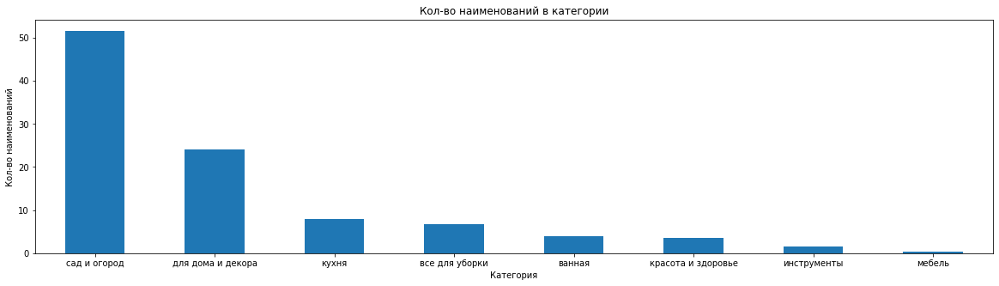

In [37]:
category_count.plot(x='category', y='ratio', kind='bar', figsize=(20, 5), legend=False)
plt.title('Кол-во наименований в категории')
plt.xlabel('Категория')
plt.ylabel('Кол-во наименований') 
plt.xticks(rotation=-0)
plt.show()

**Самую большую долю наименований у категории «cад и огород» 51.6% от общего кол-ва наименований. В этой категории, как следует из названия все для сада и огорода, а именно растения и рассада. За ней идет "для дома и декора" 24.2%, "кухня" 8.0%, "все для уборки" 6.7% и "ванная" 4.0%, "красота и здоровье" 3.5%, "инструменты" 1.6%, "мебель" 0.3%.**

## Выделение основного и дополнительного ассортимента

**Для выделения основного и дополнительного ассортимента можно использовать ABC/XYZ анализ, результат которого покажет наиболее важных и наиболее рентабельные продукты. Эта методика помогает разделить продукты или услуги на группы в зависимости от их значимости и уровня спроса.** 

In [38]:
# ABC
# рассчет доли каждого товара от общего объема продаж
data['income_share'] = data['income'] / data['income'].sum()

# сортировка товара по убыванию доли
data = data.sort_values('income_share', ascending=False)

# рассчет кумулятивной доли объема продаж
data['cum_income_share'] = data['income_share'].cumsum()

# классификация объектов
data['ABC'] = ''
data.loc[data['cum_income_share'] <= 0.8, 'ABC'] = 'A'
data.loc[(data['cum_income_share'] > 0.8) & (data['cum_income_share'] <= 0.95), 'ABC'] = 'B'
data.loc[data['cum_income_share'] >0.95, 'ABC'] = 'C'

data

,date,customer_id,order_id,product,quantity,price,day_of_week,hour,income,category,income_share,cum_income_share,ABC
1518,2019-01-15 13:00:00,58a4c3cc-504f-43ea-a74a-bae19e665552,69830,простынь вафельная 200х180 см wellness rw180-01 100% хлопок,27,1755.000000,weekday,13,47385.000000,cад и огород,0.012349,0.012349,A
1299,2018-12-21 16:00:00,6987e6d6-a63a-4ce2-a2d0-f424092d235e,69504,тележка багажная delta тбр-22 синий грузоподъемность 20 кг сумка и 50 кг каркас россия,57,574.000000,weekday,16,32718.000000,для дома и декора,0.008527,0.020876,A
1023,2018-11-29 17:00:00,8fba3604-ef57-4b9f-b2fe-3402fa8825c8,69156,набор ножей attribute chef 5 предметов akf522,64,457.000000,weekday,17,29248.000000,кухня,0.007622,0.028498,A
661,2018-11-06 12:00:00,1b2764ad-9151-4051-a46a-9b01b62e6335,68878,"урна уличная ""гео"", hobbyka/хоббика, 59*37,5см, сталь",5,4874.000000,weekday,12,24370.000000,для дома и декора,0.006351,0.034849,A
1675,2019-02-04 06:00:00,909564b8-3a5c-4d3e-8310-5ba1c837bbd7,70080,мусорный контейнер hailo bigbin swing 45 0845-010 45 л хром,3,5512.000000,weekday,6,16536.000000,для дома и декора,0.004309,0.039158,A
2971,2019-04-19 19:00:00,498f12a4-6a62-4725-8516-cf5dc9ab8a3a,71206,одеяло wellness t142 белое темостеганое 140х205 см чехол 100% полиэстер 200 г/м 4690659000306,10,1568.000000,weekday,19,15680.000000,для дома и декора,0.004086,0.043245,A
5992,2019-07-29 17:00:00,0d87f4ae-465a-4fac-81e6-5d629761783e,72139,сушилка уличная leifheit 85210 linomatic v 400 40 м 175х237х237 см зеленая,1,14917.000000,weekday,17,14917.000000,cад и огород,0.003888,0.047132,A
2970,2019-04-19 18:00:00,498f12a4-6a62-4725-8516-cf5dc9ab8a3a,71205,"наматрацник natures бархатный бамбук бб-н-1-2 односпальный, 100% хлопок, стеганый 90х200 см, с резинкой по углам, белый",12,1183.000000,weekday,18,14196.000000,для дома и декора,0.003700,0.050832,A
2969,2019-04-19 18:00:00,498f12a4-6a62-4725-8516-cf5dc9ab8a3a,71204,салфетка protec textil polyline 30х43 см аметист белая 6230,60,191.000000,weekday,18,11460.000000,кухня,0.002987,0.053818,A
4435,2019-06-04 07:00:00,940c175f-ea87-44e0-9e16-0a3d0a9abecd,71598,скатерть круглая d-175 см 50% полиэстер 50% хлопок белая wellness mld-187-эстель*01,10,1140.000000,weekday,7,11400.000000,кухня,0.002971,0.056789,A


In [39]:
data['date'] = data['date'].dt.strftime('%B %Y') #приведем дату в формат Месяц Год (прим. Март 2019)

In [40]:
#XYZ

abcxyz = data[['date', 'product', 'income']]
abcxyz_pivot = abcxyz.pivot_table(index='date', values='income', columns='product')
abcxyz_pivot.fillna(0, inplace=True)
abcxyz_pivot.astype(float)
#display(abcxyz)
display(abcxyz_pivot)

product         tepмокружка avex freeflow 700 мл зеленый avex0759  \
date                                                                
April 2019                                                    0.0   
August 2019                                                   0.0   
December 2018                                                 0.0   
December 2019                                                 0.0   
February 2019                                                 0.0   
January 2019                                                  0.0   
January 2020                                               2399.0   
July 2019                                                     0.0   
June 2019                                                     0.0   
March 2019                                                 2399.0   
May 2019                                                      0.0   
November 2018                                                 0.0   
November 2019                                                 0.0   
October 2018                                                  0.0   
October 2019                                                  0.0   
September 2019                                                0.0   

product         tepмокружка avex freeflow 700 мл сталь avex0776  \
date                                                              
April 2019                                                  0.0   
August 2019                                              2399.0   
December 2018                                               0.0   
December 2019                                               0.0   
February 2019                                               0.0   
January 2019                                                0.0   
January 2020                                                0.0   
July 2019                                                   0.0   
June 2019                                                   0.0   
March 2019                                                  0.0   
May 2019                                                    0.0   
November 2018                                               0.0   
November 2019                                               0.0   
October 2018                                                0.0   
October 2019                                                0.0   
September 2019                                              0.0   

product         tepмокружка avex recharge 500 мл голубой avex0681  \
date                                                                
April 2019                                                    0.0   
August 2019                                                   0.0   
December 2018                                                 0.0   
December 2019                                                 0.0   
February 2019                                              1874.0   
January 2019                                                  0.0   
January 2020                                                  0.0   
July 2019                                                     0.0   
June 2019                                                     0.0   
March 2019                                                    0.0   
May 2019                                                      0.0   
November 2018                                                 0.0   
November 2019                                                 0.0   
October 2018                                               2324.0   
October 2019                                                  0.0   
September 2019                                                0.0   

product         автоматическая щетка leifheit для мытья окон с ручкой 43 см. 51114  \
date                                                                                 
April 2019                                                                  7229.0   
August 2019                                      

In [41]:
abcxyz_pivot_coef = abcxyz_pivot.iloc[:, :].std() / abcxyz_pivot.iloc[:, :].mean()

abcxyz_pivot_coef = abcxyz_pivot_coef.to_frame(name='coef_cv').reset_index()

data = pd.merge(data, abcxyz_pivot_coef, on='product', how='left')
data

,date,customer_id,order_id,product,quantity,price,day_of_week,hour,income,category,income_share,cum_income_share,ABC,coef_cv
0,January 2019,58a4c3cc-504f-43ea-a74a-bae19e665552,69830,простынь вафельная 200х180 см wellness rw180-01 100% хлопок,27,1755.000000,weekday,13,47385.000000,cад и огород,0.012349,0.012349,A,4.000000
1,December 2018,6987e6d6-a63a-4ce2-a2d0-f424092d235e,69504,тележка багажная delta тбр-22 синий грузоподъемность 20 кг сумка и 50 кг каркас россия,57,574.000000,weekday,16,32718.000000,для дома и декора,0.008527,0.020876,A,3.845833
2,November 2018,8fba3604-ef57-4b9f-b2fe-3402fa8825c8,69156,набор ножей attribute chef 5 предметов akf522,64,457.000000,weekday,17,29248.000000,кухня,0.007622,0.028498,A,4.000000
3,November 2018,1b2764ad-9151-4051-a46a-9b01b62e6335,68878,"урна уличная ""гео"", hobbyka/хоббика, 59*37,5см, сталь",5,4874.000000,weekday,12,24370.000000,для дома и декора,0.006351,0.034849,A,4.000000
4,February 2019,909564b8-3a5c-4d3e-8310-5ba1c837bbd7,70080,мусорный контейнер hailo bigbin swing 45 0845-010 45 л хром,3,5512.000000,weekday,6,16536.000000,для дома и декора,0.004309,0.039158,A,3.098387
5,April 2019,498f12a4-6a62-4725-8516-cf5dc9ab8a3a,71206,одеяло wellness t142 белое темостеганое 140х205 см чехол 100% полиэстер 200 г/м 4690659000306,10,1568.000000,weekday,19,15680.000000,для дома и декора,0.004086,0.043245,A,3.630298
6,July 2019,0d87f4ae-465a-4fac-81e6-5d629761783e,72139,сушилка уличная leifheit 85210 linomatic v 400 40 м 175х237х237 см зеленая,1,14917.000000,weekday,17,14917.000000,cад и огород,0.003888,0.047132,A,4.000000
7,April 2019,498f12a4-6a62-4725-8516-cf5dc9ab8a3a,71205,"наматрацник natures бархатный бамбук бб-н-1-2 односпальный, 100% хлопок, стеганый 90х200 см, с резинкой по углам, белый",12,1183.000000,weekday,18,14196.000000,для дома и декора,0.003700,0.050832,A,4.000000
8,April 2019,498f12a4-6a62-4725-8516-cf5dc9ab8a3a,71204,салфетка protec textil polyline 30х43 см аметист белая 6230,60,191.000000,weekday,18,11460.000000,кухня,0.002987,0.053818,A,3.084876
9,June 2019,940c175f-ea87-44e0-9e16-0a3d0a9abecd,71598,скатерть круглая d-175 см 50% полиэстер 50% хлопок белая wellness mld-187-эстель*01,10,1140.000000,weekday,7,11400.000000,кухня,0.002971,0.056789,A,4.000000


In [42]:
data.loc[data['coef_cv'] >= 0.25, 'XYZ'] = 'Z'
data.loc[data['coef_cv'] < 0.25, 'XYZ'] = 'Y'
data.loc[data['coef_cv'] < 0.1, 'XYZ'] = 'X'
data

,date,customer_id,order_id,product,quantity,price,day_of_week,hour,income,category,income_share,cum_income_share,ABC,coef_cv,XYZ
0,January 2019,58a4c3cc-504f-43ea-a74a-bae19e665552,69830,простынь вафельная 200х180 см wellness rw180-01 100% хлопок,27,1755.000000,weekday,13,47385.000000,cад и огород,0.012349,0.012349,A,4.000000,Z
1,December 2018,6987e6d6-a63a-4ce2-a2d0-f424092d235e,69504,тележка багажная delta тбр-22 синий грузоподъемность 20 кг сумка и 50 кг каркас россия,57,574.000000,weekday,16,32718.000000,для дома и декора,0.008527,0.020876,A,3.845833,Z
2,November 2018,8fba3604-ef57-4b9f-b2fe-3402fa8825c8,69156,набор ножей attribute chef 5 предметов akf522,64,457.000000,weekday,17,29248.000000,кухня,0.007622,0.028498,A,4.000000,Z
3,November 2018,1b2764ad-9151-4051-a46a-9b01b62e6335,68878,"урна уличная ""гео"", hobbyka/хоббика, 59*37,5см, сталь",5,4874.000000,weekday,12,24370.000000,для дома и декора,0.006351,0.034849,A,4.000000,Z
4,February 2019,909564b8-3a5c-4d3e-8310-5ba1c837bbd7,70080,мусорный контейнер hailo bigbin swing 45 0845-010 45 л хром,3,5512.000000,weekday,6,16536.000000,для дома и декора,0.004309,0.039158,A,3.098387,Z
5,April 2019,498f12a4-6a62-4725-8516-cf5dc9ab8a3a,71206,одеяло wellness t142 белое темостеганое 140х205 см чехол 100% полиэстер 200 г/м 4690659000306,10,1568.000000,weekday,19,15680.000000,для дома и декора,0.004086,0.043245,A,3.630298,Z
6,July 2019,0d87f4ae-465a-4fac-81e6-5d629761783e,72139,сушилка уличная leifheit 85210 linomatic v 400 40 м 175х237х237 см зеленая,1,14917.000000,weekday,17,14917.000000,cад и огород,0.003888,0.047132,A,4.000000,Z
7,April 2019,498f12a4-6a62-4725-8516-cf5dc9ab8a3a,71205,"наматрацник natures бархатный бамбук бб-н-1-2 односпальный, 100% хлопок, стеганый 90х200 см, с резинкой по углам, белый",12,1183.000000,weekday,18,14196.000000,для дома и декора,0.003700,0.050832,A,4.000000,Z
8,April 2019,498f12a4-6a62-4725-8516-cf5dc9ab8a3a,71204,салфетка protec textil polyline 30х43 см аметист белая 6230,60,191.000000,weekday,18,11460.000000,кухня,0.002987,0.053818,A,3.084876,Z
9,June 2019,940c175f-ea87-44e0-9e16-0a3d0a9abecd,71598,скатерть круглая d-175 см 50% полиэстер 50% хлопок белая wellness mld-187-эстель*01,10,1140.000000,weekday,7,11400.000000,кухня,0.002971,0.056789,A,4.000000,Z


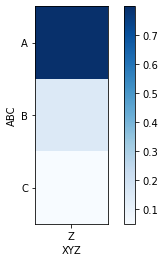

In [43]:
# Формирование матрицы ABC-XYZ
matrix = pd.pivot_table(data, values='income_share', index='ABC', columns='XYZ', aggfunc='sum')

# Визуализация матрицы ABC-XYZ
plt.imshow(matrix, interpolation='nearest', cmap='Blues')
plt.xticks(range(matrix.shape[1]), matrix.columns)
plt.yticks(range(matrix.shape[0]), matrix.index)
plt.colorbar()
plt.xlabel('XYZ')
plt.ylabel('ABC')
plt.show()

In [44]:
data['ABC/XYZ'] = data['ABC'] + data['XYZ']
data.sample(5)

,date,customer_id,order_id,product,quantity,price,day_of_week,hour,income,category,income_share,cum_income_share,ABC,coef_cv,XYZ,ABC/XYZ
1409,December 2018,389ddf57-f8bf-409d-bf42-ea7c6743ce70,69205,сковорода алюминиевая с антипригарным покрытием marble alpenkok d = 22 см ak-0037a/22n,1,712.0,weekday,16,712.0,кухня,0.000186,0.779302,A,4.000000,Z,AZ
3396,November 2018,8851c688-9846-4ec3-a3cc-6b07754c45bb,69081,"герань домашняя (пеларгония зональная) цветущая d12, h25-30, белая, полумахровая",1,149.0,weekday,21,149.0,cад и огород,0.000039,0.947324,B,2.149935,Z,BZ
5407,September 2019,04416514-5346-4f90-93e3-fb7365e2ee8c,72627,решетка вентиляционная металлическая золото 17х17 см 1710035,1,30.0,weekend,13,30.0,для дома и декора,0.000008,0.999208,C,4.000000,Z,CZ
5167,December 2018,33375310-60ae-4c95-86f4-7bed8d0b3d3e,69541,сервировочная салфетка пвх 26х41 см капучино 6163,2,22.0,weekday,1,44.0,кухня,0.000011,0.996826,C,4.000000,Z,CZ
3113,October 2018,4d59d9e7-55be-43a0-88c4-8e7261c5c6d5,68610,цикламен d-13 см,1,164.0,weekday,13,164.0,cад и огород,0.000043,0.936043,B,4.000000,Z,BZ


In [45]:
data_group = data.groupby(['category', 'ABC/XYZ'])['product'].nunique()
display(data_group)
print(data.groupby('ABC/XYZ')['product'].nunique())

category            ABC/XYZ
cад и огород        AZ         155
                    BZ         428
                    CZ         523
ванная              AZ          71
                    BZ          50
                    CZ          18
все для уборки      AZ         115
                    BZ          58
                    CZ          36
для дома и декора   AZ         325
                    BZ         207
                    CZ         143
инструменты         AZ          36
                    BZ           7
                    CZ          17
красота и здоровье  AZ          29
                    BZ          51
                    CZ          55
кухня               AZ         131
                    BZ         122
                    CZ          69
мебель              AZ           9
                    BZ           4
Name: product, dtype: int64

ABC/XYZ
AZ    871
BZ    927
CZ    861
Name: product, dtype: int64


**Группы**
 - **AX и BX** — обеспечивают основной доход и при этом стабильно продаются. Они всегда должны быть на складе. Необходимый запас легко спрогнозировать, так как объемы продаж почти не меняются от месяца к месяцу.
 
 - **АY и BY** — это тоже высокий доход, но стабильность продаж уже ниже. По этим товарам на складе необходимо создать дополнительные резервы, на случай роста спроса в отдельные периоды. Резерв нужен обязательно, это важные для компании группы, которые приносят значительную часть дохода.
 
 - **AZ и BZ** — приносят существенный доход. Но спрос на них почти невозможно спрогнозировать. Если создавать запасы на складе, исходя из максимально возможной месячной выручки, то значительная часть товара может остаться непроданной. Поэтому лучше использовать другие способы, которые обеспечат нужное количество товара. Например, заключить договоры с поставщиками, которые находятся максимально близко от магазина и могут в любой момент привезти нужную партию.
 
 - **CX** — продается стабильно, но в небольших объемах. По этой позиции нужно создать постоянный запас, исходя из среднего объема продаж.
 
 - **CY** — небольшие объемы продаж и невысокая стабильность. Запасы этой группы нужно создавать по остаточному принципу, т. е. после того, как выделены деньги на закупки товаров из более выгодных групп. Даже если в какой-то момент товара из этой группы не окажется на складе, потери компании будут невелики.
 
 - **CZ** — самые низкие объемы выручки, при этом спрос невозможно спрогнозировать. Сюда относятся товары, которые уже перестали пользоваться спросом. Запасы по этой категории обычно не создают, работают под заказ.  В эту группу могут попасть и новинки. Они не пользуются спросом потому, что клиенты пока о них не знают.

**По результатам ABC/XYZ анализа мы видим, что с ассортиментом все не очень радужно. Самое большое кол-во наименований в группе CZ, что означает, что товар не пользуется спросом у покупателей, т.к. его сложно спрогнозировать. Далее идет AZ и BZ, от данных групп товаров приходит существенный доход, но опять же спрос на эти товары сложно спрогнозировать. И все же, в конкретном случае, к основному ассортименту я бы отнес товар из группы AZ, а BZ и CZ уже к дополнительному.**

## Проверка гипотез

**Гипотеза №1**

Сформулируем нулевую и альтернативную гипотезы:
 - **Нулевая гипотеза H₀**: Средние объёмы продаж в будни и выходные **одинаковые**.
 - **Альтернативная гипотеза H₁**: Средние объёмы продаж в будни и выходные **разные**.

Для проверки гипотез мы ранее выделили выходные и будние дни

In [46]:
weekday = data[data['day_of_week']=='weekday']['income']
weekend = data[data['day_of_week']=='weekend']['income']

In [47]:
# Выполним проверку гипотезы. Будем использовать метод ttest_ind.
alpha = 0.05

results = st.ttest_ind(weekday, weekend)

print('p-значение:', results.pvalue)

if (results.pvalue < alpha):
    print("Отвергаем нулевую гипотезу")
else:
    print("Не получилось отвергнуть нулевую гипотезу")

p-значение: 0.016160004096037
Отвергаем нулевую гипотезу


In [48]:
print("Cреднее значение объёма продаж в будние: {} ".format(int(np.mean(weekday))))
print("Cреднее значение объёма продаж в выходные: {} ".format(int(np.mean(weekend))))

Cреднее значение объёма продаж в будние: 714 
Cреднее значение объёма продаж в выходные: 599 


Проведенный тест показал, что средние объёмы продаж в будни и выходные **разные**

**Гипотеза №2**

Для уточнения формулировки, посмотрим на уникальные значения `hour`

In [49]:
#уникальные часы
display(data['hour'].unique())
#кол-во уникальных часов
display(data['hour'].nunique())

array([13, 16, 17, 12,  6, 19, 18,  7, 15,  9, 11,  8, 10,  1, 22, 14, 23,
        2, 21, 20,  0,  4,  5,  3])

24

Сформулируем нулевую и альтернативную гипотезы:
 - **Нулевая гипотеза H₀**: среднее кол-во заказов с 17:00 до 22:00 и среднее кол-во заказов в остальные часы **одинаковое**
 - **Альтернативная гипотеза H₁**: среднее кол-во заказов с 17:00 до 22:00 и среднее кол-во заказов в остальные часы **разное**

In [50]:
hour_range = data[data['hour'].between(17, 22)]['order_id']
other_hours = data[~data['hour'].between(17, 22)]['order_id']

In [51]:
#проверка гипотезы

alpha = 0.05

results = st.ttest_ind(other_hours, hour_range)

print('p-значение:', results.pvalue)

if (results.pvalue < alpha):
    print("Отвергаем нулевую гипотезу")
else:
    print("Не получилось отвергнуть нулевую гипотезу")

p-значение: 0.031555273405093925
Отвергаем нулевую гипотезу


In [52]:
print("Cреднее кол-во заказов с 17:00 до 22:00: {} ".format(int(np.mean(hour_range))))
print("Cреднее кол-ва заказов с 23:00 до 16:00: {} ".format(int(np.mean(other_hours))))

Cреднее кол-во заказов с 17:00 до 22:00: 49777 
Cреднее кол-ва заказов с 23:00 до 16:00: 51479 


Проведенный тест показал, что среднее кол-во заказов с 17:00 до 22:00 и среднее кол-во заказов в остальные часы **разное**

## Общие выводы

После проведенного анализа ассортимента интернет-магазина «Пока все ещё тут» мы выяснили:

- данными которыми располагаем: с 2018-10-01 по 2020-01-31 или 16 месяцев. 
- ассортимент магазина представлен 2340 уникальными товарами;
- разделили товар на категории: 
  - cад и огород       —  947 наим.
  - для дома и декора  —  589 наим.
  - кухня              —  294 наим.
  - все для уборки     —  191 наим.
  - ванная             —  130 наим.
  - красота и здоровье —  122 наим.
  - инструменты        —   54 наим.
  - мебель             —   13 наим.
- Провели ABC\XYZ анализ, который показал, что треть товара (СZ группа) довольно плохо продается, для товара этой группы можно перейти на прямые поставки. Т.е. если появился клиент который хочет конкретный товар из данной группы, то отгрузку ему произведут со склада производителя, дилера или оптового торговца. Оставшаяся часть AZ и BZ, хоть и приносят хороший доход, но все же сложно спрогнозировать, когда этот товар будет продан, может и месяц пролежать на складе прежде чем его купят.
- Сформулировали и проверили гипотезы: 
  
  **Гипотеза №1**
            H₀: Средние объёмы продаж в будни и выходные одинаковые
            H₁: Средние объёмы продаж в будни и выходные разные. 
  В результате чего проведенный тест показал, что средние объёмы продаж в будни и выходные **разные**
  
  **Гипотеза №2**
            H₀: среднее кол-во заказов с 17:00 до 22:00 и среднее кол-во заказов в остальные часы одинаковое
            H₁: среднее кол-во заказов с 17:00 до 22:00 и среднее кол-во заказов в остальные часы разное;
  В результате чего проведенный тест показал, что среднее кол-во заказов с 17:00 до 22:00 и среднее кол-во заказов в остальные часы **разное**
  
  
- [Презентация](https://tinyurl.com/kzbu47t6);
- [Дашборд](https://tinyurl.com/2x733mzj).